# Classify pets - runtime

This notebook loads a pre-trained model and runs classification on it

In [3]:
from fastai import vision
from fastai.metrics import error_rate
from pathlib import Path

In [7]:
path=Path('C:/Users/atma6951/.fastai/data/oxford-iiit-pet')
print(path.ls())
path_anno = path/'annotations'
path_img = path/'images'

[WindowsPath('C:/Users/atma6951/.fastai/data/oxford-iiit-pet/annotations'), WindowsPath('C:/Users/atma6951/.fastai/data/oxford-iiit-pet/images')]


In [8]:
fnames = vision.data.get_image_files(path_img)
len(fnames)

7390

In [11]:
pat = r'/([^/]+)_\d+.jpg$'
data = vision.data.ImageDataBunch.from_name_re(path_img, 
                                              fnames, pat, 
                                              ds_tfms=vision.transform.get_transforms(), 
                                              size=224, bs=64)
data = data.normalize(vision.imagenet_stats)

In [12]:
# create a learner
learn = vision.learner.cnn_learner(data, vision.models.resnet34, metrics=error_rate)

In [15]:
learn.load(file=path_img/'models'/'pets-lesson01-stage-2')

Learner(data=ImageDataBunch;

Train: LabelList (5912 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
Abyssinian,Abyssinian,Abyssinian,Abyssinian,Abyssinian
Path: C:\Users\atma6951\.fastai\data\oxford-iiit-pet\images;

Valid: LabelList (1478 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
saint_bernard,Russian_Blue,Ragdoll,chihuahua,Ragdoll
Path: C:\Users\atma6951\.fastai\data\oxford-iiit-pet\images;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_s

## Predict

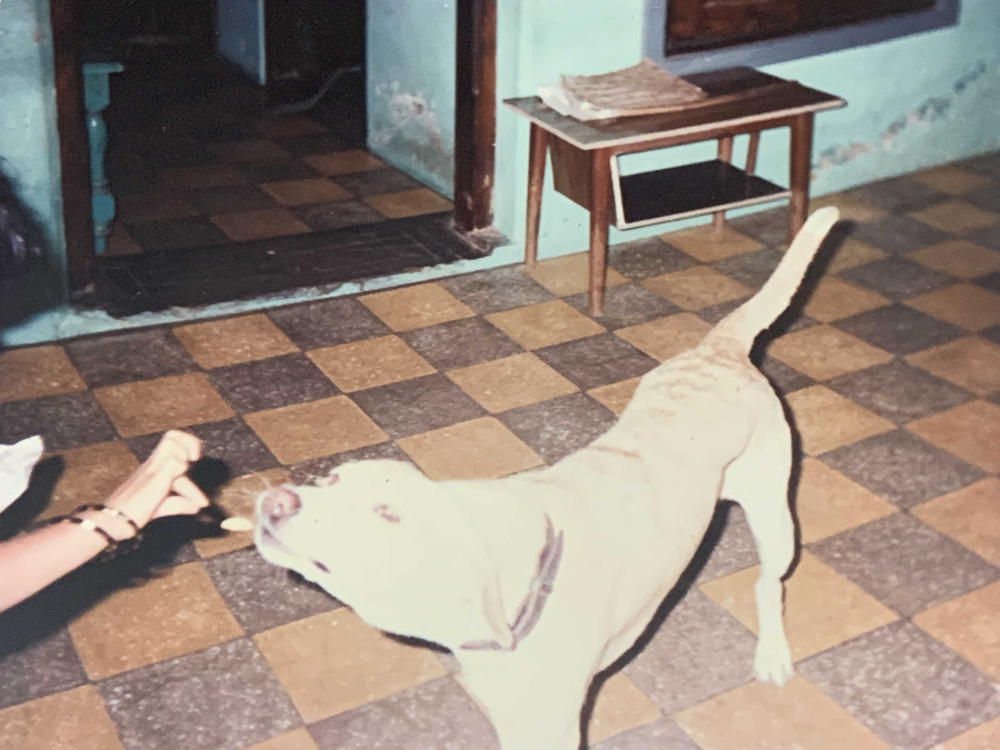

In [16]:
img1 = vision.image.open_image('c:/gis_data/dl/my-pets/IMG_9783.jpg')
img1

In [19]:
pred1= learn.predict(img1)
pred1

(Category tensor(35),
 tensor(35),
 tensor([0.0052, 0.0453, 0.0252, 0.0145, 0.0095, 0.0140, 0.0251, 0.1024, 0.0096,
         0.0038, 0.0209, 0.0090, 0.0017, 0.0058, 0.0205, 0.0050, 0.0010, 0.0031,
         0.0043, 0.0007, 0.0097, 0.0022, 0.0066, 0.0029, 0.0061, 0.0008, 0.0070,
         0.0056, 0.0016, 0.0124, 0.0020, 0.0052, 0.0083, 0.0063, 0.0024, 0.5812,
         0.0130]))

In [23]:
cat1 = pred1[0]

In [25]:
cat1.obj

'wheaten_terrier'

In [27]:
list(zip(list(range(0,data.c)),data.classes, list(pred1[2])))

[(0, 'Abyssinian', tensor(0.0052)),
 (1, 'Bengal', tensor(0.0453)),
 (2, 'Birman', tensor(0.0252)),
 (3, 'Bombay', tensor(0.0145)),
 (4, 'British_Shorthair', tensor(0.0095)),
 (5, 'Egyptian_Mau', tensor(0.0140)),
 (6, 'Maine_Coon', tensor(0.0251)),
 (7, 'Persian', tensor(0.1024)),
 (8, 'Ragdoll', tensor(0.0096)),
 (9, 'Russian_Blue', tensor(0.0038)),
 (10, 'Siamese', tensor(0.0209)),
 (11, 'Sphynx', tensor(0.0090)),
 (12, 'american_bulldog', tensor(0.0017)),
 (13, 'american_pit_bull_terrier', tensor(0.0058)),
 (14, 'basset_hound', tensor(0.0205)),
 (15, 'beagle', tensor(0.0050)),
 (16, 'boxer', tensor(0.0010)),
 (17, 'chihuahua', tensor(0.0031)),
 (18, 'english_cocker_spaniel', tensor(0.0043)),
 (19, 'english_setter', tensor(0.0007)),
 (20, 'german_shorthaired', tensor(0.0097)),
 (21, 'great_pyrenees', tensor(0.0022)),
 (22, 'havanese', tensor(0.0066)),
 (23, 'japanese_chin', tensor(0.0029)),
 (24, 'keeshond', tensor(0.0061)),
 (25, 'leonberger', tensor(0.0008)),
 (26, 'miniature_pinsc

Abyssinian


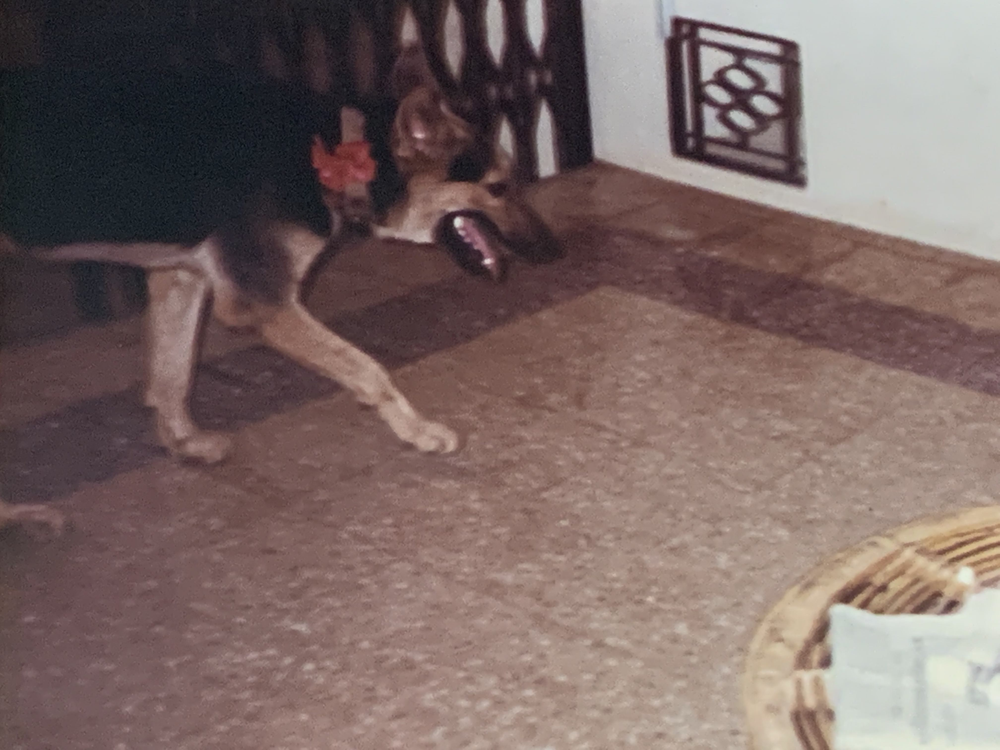

In [28]:
img2 = vision.image.open_image('c:/gis_data/dl/my-pets/IMG_9784.jpg')
pred2 = learn.predict(img2)
print(pred2[0].obj)
img2

Abyssinian


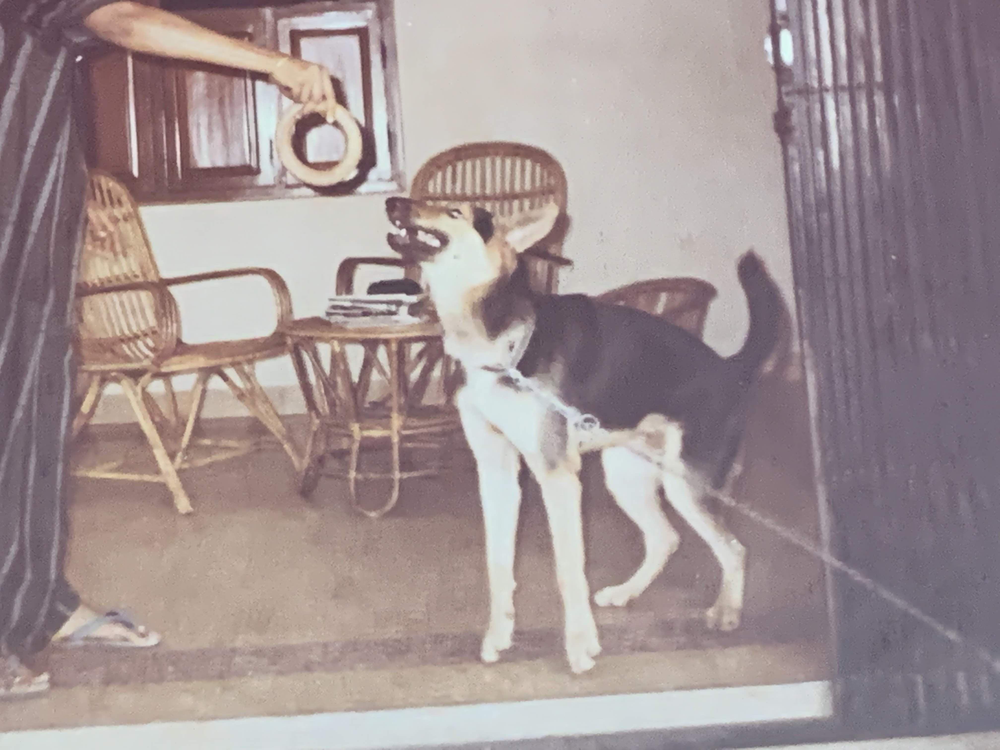

In [29]:
img3 = vision.image.open_image('c:/gis_data/dl/my-pets/IMG_9785.jpg')
pred3 = learn.predict(img2)
print(pred3[0].obj)
img3